In [2]:
%pylab inline
import pandas as pd
import xarray as xr

import plotly.io as pio
pio.renderers.default='iframe'
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px
import plotly.figure_factory as ff
#import chart_studio.plotly as py

#import meteolib as ml
#from climate_indices import indices

Populating the interactive namespace from numpy and matplotlib


In [3]:
#helper for key references
def skey(string):
    try:
        rx = pd.Series(string.split('.'),index=['institute','GCM','RCM','ensemble','RCP'])
        return rx[['GCM','RCM','RCP','ensemble','institute']]
    except:
        rx = pd.Series(string.split('.'),index=['GCM','ensemble','RCM','RCP'])
        rx['institute'] = ''
        return rx[['GCM','RCM','RCP','ensemble','institute']]


In [8]:
#load data
scPDSIx = pd.read_csv('cordex_coast_nobias_scPDSI.csv', index_col=0)
scPDSIx.index = pd.to_datetime(scPDSIx.index)
scPDSIx

,CLMcom-ETH.M-MPI-ESM-LR.COSMO-crCLIM-v1-1.r1i1p1.rcp85,CLMcom-ETH.M-MPI-ESM-LR.COSMO-crCLIM-v1-1.r2i1p1.rcp85,CLMcom-ETH.M-MPI-ESM-LR.COSMO-crCLIM-v1-1.r3i1p1.rcp85,CLMcom-ETH.NorESM1-M.COSMO-crCLIM-v1-1.r1i1p1.rcp85,CLMcom.CERFACS-CNRM-CM5.CCLM4-8-17.r1i1p1.rcp45,CLMcom.CERFACS-CNRM-CM5.CCLM4-8-17.r1i1p1.rcp85,CLMcom.EC-EARTH.CCLM4-8-17.r12i1p1.rcp26,CLMcom.EC-EARTH.CCLM4-8-17.r12i1p1.rcp45,CLMcom.EC-EARTH.CCLM4-8-17.r12i1p1.rcp85,CLMcom.MIROC5.CCLM4-8-17.r1i1p1.rcp26,...,DWD.M-MPI-ESM-LR.EPISODES2018.r1i1p1.rcp45,DWD.M-MPI-ESM-LR.EPISODES2018.r2i1p1.rcp45,DWD.M-MPI-ESM-LR.EPISODES2018.r3i1p1.rcp45,DWD.M-MPI-ESM-LR.EPISODES2018.r1i1p1.rcp85,DWD.M-MPI-ESM-LR.EPISODES2018.r2i1p1.rcp85,DWD.M-MPI-ESM-LR.EPISODES2018.r3i1p1.rcp85,DWD.NorESM1-M.EPISODES2018.r1i1p1.historical,DWD.NorESM1-M.EPISODES2018.r1i1p1.rcp26,DWD.NorESM1-M.EPISODES2018.r1i1p1.rcp45,DWD.NorESM1-M.EPISODES2018.r1i1p1.rcp85
time,,,,,,,,,,,,,,,,,,,,,
2006-01-31,-0.090673,0.525336,0.276002,0.020515,0.253979,0.081563,0.707127,0.635867,0.361659,0.586484,...,-0.318772,0.185935,0.139059,-0.082659,0.211055,0.572111,0.0,0.341411,0.443324,0.096234
2006-02-28,0.464411,1.342623,-0.142593,0.261802,-0.201978,0.272219,0.903183,-0.236536,0.410081,0.445100,...,0.332550,0.310017,-0.330112,0.086042,0.716508,0.611483,0.0,0.580866,0.546180,0.380232
2006-03-31,2.030025,1.289503,-0.096042,0.627191,-0.073579,0.248657,1.528549,-0.381305,1.021708,1.121136,...,-0.394124,-0.319683,0.211183,1.257622,1.116211,0.777930,0.0,0.640636,0.592828,0.733948
2006-04-30,2.168046,-0.220724,-0.671472,0.970728,-0.518895,0.205158,1.803735,-0.524969,1.266246,1.085367,...,-0.722411,-0.261057,0.744848,-0.034548,2.002681,0.403221,0.0,0.633887,1.638219,1.088142
2006-05-31,1.771406,-0.356369,0.545582,0.622378,0.322010,0.348066,1.948532,0.021046,-0.367459,-0.245857,...,-0.556313,-0.393947,0.800585,-0.434590,1.766322,0.187231,0.0,0.997432,1.958280,0.882537
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2099-08-31,3.806852,1.703926,-1.379460,1.193350,1.343778,1.271252,0.823392,-0.259282,-1.230700,1.256850,...,4.343813,1.075888,-2.114170,-0.517632,-3.421036,-1.081936,0.0,1.698805,-4.222616,-1.419663
2099-09-30,3.566222,2.070874,-1.824597,0.755246,1.592201,0.804148,0.853990,-0.663855,-1.180529,1.384921,...,3.989754,1.094114,-2.168845,-0.881406,-2.558949,-1.552309,0.0,1.935810,-4.717659,-1.772264
2099-10-31,3.368120,1.634429,-2.411798,0.633223,1.471754,1.051024,1.069791,2.208335,-1.749631,1.931364,...,3.995272,1.392623,-2.468144,-0.972437,-3.087494,-1.857098,0.0,1.714778,-5.265738,-2.105829


In [5]:
#build index
#get sorted index
idx = pd.concat([pd.Series(scPDSIx.columns[scPDSIx.columns.str.endswith('.rcp26')].sort_values()),pd.Series(scPDSIx.columns[scPDSIx.columns.str.endswith('.rcp45')].sort_values()),pd.Series(scPDSIx.columns[scPDSIx.columns.str.endswith('.rcp85')].sort_values())]).values
idx_nosort = pd.concat([pd.Series(scPDSIx.columns[scPDSIx.columns.str.endswith('.rcp26')]),pd.Series(scPDSIx.columns[scPDSIx.columns.str.endswith('.rcp45')]),pd.Series(scPDSIx.columns[scPDSIx.columns.str.endswith('.rcp85')])]).values
idxx = [len(scPDSIx.columns[scPDSIx.columns.str.endswith('.rcp26')]), len(scPDSIx.columns[scPDSIx.columns.str.endswith('.rcp45')]), len(scPDSIx.columns[scPDSIx.columns.str.endswith('.rcp85')])]

In [ ]:
#plot sorted by GCM
fig = px.imshow(scPDSIx[idx], color_continuous_scale='RdBu', origin='lower',template='none')
fig.add_trace(go.Scatter(x=[idx[idxx[0]],idx[idxx[0]]],y=[scPDSIx.index[0],scPDSIx.index[-1]], mode='lines', line = dict(color='black', width=2, dash='dash'), showlegend=False))
fig.add_trace(go.Scatter(x=[idx[idxx[0]+idxx[1]],idx[idxx[0]+idxx[1]]],y=[scPDSIx.index[0],scPDSIx.index[-1]], mode='lines', line = dict(color='black', width=2, dash='dash'), showlegend=False))
fig.update_layout(title='scPDSI', xaxis_title='Climate Simulation', yaxis_title='Year') #yaxis_title='‹‹– dry ‹‹– Drought Index –›› wet -››'
#py.plot(fig, filename = 'scPDSI', auto_open=True)
fig.show()

In [ ]:
#plot sorted by RCM
fig = px.imshow(scPDSIx[idx_nosort], color_continuous_scale='RdBu', origin='lower',template='none')
fig.add_trace(go.Scatter(x=[idx_nosort[idxx[0]],idx_nosort[idxx[0]]],y=[scPDSIx.index[0],scPDSIx.index[-1]], mode='lines', line = dict(color='black', width=2, dash='dash'), showlegend=False))
fig.add_trace(go.Scatter(x=[idx_nosort[idxx[0]+idxx[1]],idx_nosort[idxx[0]+idxx[1]]],y=[scPDSIx.index[0],scPDSIx.index[-1]], mode='lines', line = dict(color='black', width=2, dash='dash'), showlegend=False))
fig.update_layout(title='scPDSI', xaxis_title='Climate Simulation', yaxis_title='Year') #yaxis_title='‹‹– dry ‹‹– Drought Index –›› wet -››'
#py.plot(fig, filename = 'scPDSI', auto_open=True)
fig.show()

# RUINS implementation

In [2]:
from ruins.core import build_config, DataManager, Config
import plotly.graph_objects as go

In [3]:
config, dataManager = build_config()

In [4]:
pdsi = dataManager.read('scPDSI')
#pdsi

In [4]:
import plotly.express as px

fig = px.imshow(pdsi.dropna(), color_continuous_scale='RdBu', origin='lower',template='none')
fig.update_layout(yaxis=dict(title='Year'))

In [5]:
unpack = [c.split('.') for c in pdsi.columns]

rcp = [u[-1] for u in unpack]
gcm = [u[1] if len(u)==5 else u[0] for u in unpack]
rcm = [u[2] if len(u)==5 else u[2] for u in unpack]

set(rcp)

{'historical', 'rcp26', 'rcp45', 'rcp85'}

In [6]:
import pandas as pd
p = pdsi.copy()
p.columns = pd.MultiIndex.from_tuples(zip(rcp, gcm, pdsi.columns.to_list()))



In [7]:
midx, indexer = p.columns.sortlevel([0,1])

p = p.iloc[:, indexer].copy()
p


historical  \
                                              CERFACS-CNRM-CM5   
           DWD.CERFACS-CNRM-CM5.EPISODES2018.r1i1p1.historical   
time                                                             
2006-01-31                                                0.0    
2006-02-28                                                0.0    
2006-03-31                                                0.0    
2006-04-30                                                0.0    
2006-05-31                                                0.0    
...                                                       ...    
2099-08-31                                                0.0    
2099-09-30                                                0.0    
2099-10-31                                                0.0    
2099-11-30                                                0.0    
2099-12-31                                                0.0    

                                                       \
                                              CanESM2   
           DWD.CanESM2.EPISODES2018.r1i1p1.historical   
time                                                    
2006-01-31                                        0.0   
2006-02-28                                        0.0   
2006-03-31                                        0.0   
2006-04-30                                        0.0   
2006-05-31                                        0.0   
...                                               ...   
2099-08-31                                        0.0   
2099-09-30                                        0.0   
2099-10-31                                        0.0   
2099-11-30                                        0.0   
2099-12-31                                        0.0   

                                                       \
                                                        
           DWD.CanESM2.EPISODES2018.r2i1p1.historical   
time                                                    
2006-01-31                                        0.0   
2006-02-28                                        0.0   
2006-03-31                                        0.0   
2006-04-30                                        0.0   
2006-05-31                                        0.0   
...                                               ...   
2099-08-31                                        0.0   
2099-09-30                                        0.0   
2099-10-31                                        0.0   
2099-11-30                                        0.0   
2099-12-31                                        0.0   

                                                       \
                                                        
           DWD.CanESM2.EPISODES2018.r3i1p1.historical   
time                                                    
2006-01-31                                        0.0   
2006-02-28                                        0.0   
2006-03-31                                        0.0   
2006-04-30                                        0.0   
2006-05-31                                        0.0   
...                                               ...   
2099-08-31                                        0.0   
2099-09-30                                        0.0   
2099-10-31                                        0.0   
2099-11-30                                        0.0   
2099-12-31                                        0.0   

                                                       \
                                                        
           DWD.CanESM2.EPISODES2018.r4i1p1.historical   
time                                                    
2006-01-31                                        0.0   
2006-02-28                                        0.0   
2006-03-31                                        0.0   
2006-04-30                                        0.0   
2006-05-31                           

In [8]:
lvl0 = p.columns.get_level_values(0)
labels = lvl0.unique().tolist()
n_cols = len(p.columns)
pos = [*[lvl0.tolist().index(l) for l in labels], n_cols - 1]

#fig = px.imshow(p, color_continuous_scale='RdBu', origin='lower',template='none')
fig = go.Figure(go.Heatmap(z=p.values, y=p.index, colorscale='RdBu'))

for l, u, lab in zip(pos[:-1], pos[1:], labels):
    fig.add_annotation(x=u, ax=l, y=-.03, ay=-.03, xref='x', axref='x', yref='paper', arrowside='start+end', arrowhead=2, showarrow=True)
    fig.add_annotation(x=int(l + (u - l) / 2), y=-.1, xref='x', yref='paper', text=lab.upper(), showarrow=False)


fig.update_layout(
    yaxis=dict(title='Year'),
    xaxis=dict(showticklabels=False, showline=False)
)


### Tree layout

In [19]:
import igraph
from igraph import Graph, EdgeSeq

Gr = Graph()
Gr.add



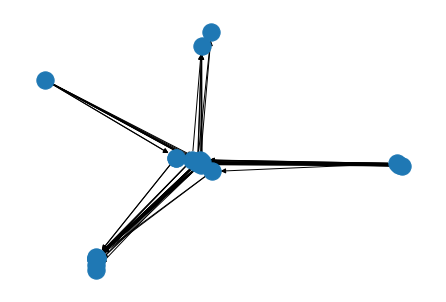

In [18]:
import networkx as nx

G = nx.DiGraph()

for r, g, re in zip(rcp, gcm, rcm):
    G.add_edge(r, g)
    G.add_edge(g, re)

G
nx.draw_kamada_kawai(G)

In [26]:
pdsi.columns.levels

AttributeError: 'Index' object has no attribute 'levels'

In [22]:
from plotly.subplots import make_subplots

def tree_plot(data: pd.DataFrame, heights=[1, 0.3, 0], fig: go.Figure = None, row: int = 1, col: int = 1) -> go.Figure:
    # LEVELS = len(data.columns.levels) - 1
    LEVELS = 1
    RY, CY, LY = heights

    if fig is None:
        #fig = make_subplots(2, 1, shared_xaxes=True, row_heights=[0.35, 0.65])
        fig = make_subplots(1, 1)

    # get the root nodes
    roots = data.columns.get_level_values(0).unique().tolist()
    rootpos = [data.columns.get_level_values(0).tolist().index(r) for r in roots] + [len(data.columns)]

    # main crazy root

    # go for each root node with upper and lower limit on the x-axis
    for l, u , lab in zip(rootpos[:-1], rootpos[1:], roots):
        fig.add_annotation(x=int(l + (u - l) / 2), y=RY * 1.05, xref='x', yref='y', showarrow=False, text=lab.upper(), row=row, col=col)  

        # go for children 
        ch = data[lab].columns.get_level_values(0)
        childs = ch.unique().tolist()
        cpos = [l + ch.tolist().index(c) for c in childs] + [l + len(ch)]

        # get the plotting positions
        c_x = [int(cl + (cu - cl) / 2) for cl, cu in zip(cpos[:-1], cpos[1:])]
        c_y = [CY for _ in range(len(c_x))]
        fig.add_trace(go.Scatter(x=c_x, y=c_y, mode='markers', marker=dict(color='black', size=8), text=childs, showlegend=False, hovertemplate='%{text}<extra></extra>'), row=row, col=col)
    
    
        # go for each child node and add the traces
        for (cl, cu, clab) in zip(cpos[:-1], cpos[1:], childs):
            #fig.add_annotation(x=int(cl + (cu - cl) / 2), y=CY, xref='x', yref='y', ax=int(l + (u - l) / 2), ay=RY, axref='x', ayref='y', showarrow=True, arrowwidth=0.5)
            fig.add_trace(
                go.Scattergl(x=[int(cl + (cu - cl) / 2), int(l + (u - l) / 2)], y=[CY, RY], mode='lines', line=dict(color='black', width=0.9), showlegend=False),
                row=row, col=col
            )

        if LEVELS == 1:
            continue
        # go for each leaf in this child
            for child in childs:
                leafs = data[(lab, clab)].columns.get_level_values(0).tolist()
                l_x = [cl + _ for _ in range(len(leafs))]
                l_y = [LY for _ in range(len(l_x))]

                # markers
                fig.add_trace(
                    go.Scatter(x=l_x, y=l_y, mode='markers', marker=dict(color='black', size=2), text=leafs, showlegend=False, hovertemplate="%{text}<extra></extra>"), 
                    row=row, col=col
                )

                for _x, _y in zip(l_x, l_y):
                    #fig.add_annotation(x=_x, y=_y, xref='x', yref='y', ax=int(cl + (cu - cl) / 2), ay=1., axref='x', ayref='y', showarrow=True, arrowwidth=0.5)
                    fig.add_trace(
                        go.Scattergl(x=[_x, int(cl + (cu - cl) / 2)], y=[LY, CY], mode='lines', line=dict(color='black', width=0.5), showlegend=False),
                        row=row, col=col
                    )
    # general layout
    fig.update_layout(
        template='none',
        xaxis=dict(range=[-2, len(data.columns) + 2], showticklabels=False, showline=False, zeroline=False, showgrid=False),
        yaxis=dict(showticklabels=False, showline=False, zeroline=False, showgrid=False),
    )

    # return 
    return fig


tree_plot(p)

In [13]:
def pdsi_plot(data: pd.DataFrame, colorscale: str = 'RdBu', fig: go.Figure = None, row: int = 1, col: int = 1, **kwargs) -> go.Figure:
    """Heatmap plot for Palmer drought severity index"""
    # check if the data has been grouped
    is_grouped = isinstance(data.columns, pd.MultiIndex)


    # create the figure
    if fig is None:
        fig = make_subplots(rows=1, cols=1)

    fig.add_trace(go.Heatmap(y=data.index, z=data.values, colorscale=colorscale), row=row, col=col)
    
    if is_grouped:
        # extract the level
        lvl0 = data.columns.get_level_values(0)
        labels = lvl0.unique().tolist()
        n_cols = len(data.columns)
        positions = [*[lvl0.tolist().index(l) for l in labels], n_cols - 1]

        # add the annotations
        for l, u, lab in zip(positions[:-1], positions[1:], labels):
            fig.add_annotation(x=u, ax=l, y=-.03, ay=-.03, xref='x', axref='x', yref='paper', arrowside='start+end', arrowhead=2, showarrow=True)
            fig.add_annotation(x=int(l + (u - l) / 2), y=-.1, xref='x', yref='paper', text=lab.upper(), showarrow=False)

        # remove the x-axis
        fig.update_layout(**{
            f'xaxis{row}': dict(showticklabels=False, showline=False)
        })
         
    # general layout
    fig.update_layout(**{
        f'yaxis{row}': dict(title='Jahr' if kwargs.get('lang', 'de')=='de' else 'Year', range=[data.index.min(), data.index.max()]),
    })

    # return
    return fig

In [19]:
fig = make_subplots(2, 1, shared_xaxes=True, vertical_spacing=0.0, row_heights=[0.35, 0.65])

tree_plot(p, fig=fig, row=1, col=1)
pdsi_plot(p, fig=fig, row=2, col=1)

In [31]:
from ruins.processing.pdsi import multiindex_pdsi_data

p2 = multiindex_pdsi_data(pdsi, grouping=['gcm', 'rcm', 'rcp'])

len(p2.columns.levels)

4